# Visualisations

In [282]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
plt.style.use('ggplot')
import seaborn as sns
import folium
import json
import nltk as nl
from nltk.corpus import stopwords
from nltk.stem import RSLPStemmer
from nltk.tokenize import word_tokenize, sent_tokenize
nl.download('punkt')
nl.download('stopwords')
nl.download('rslp')
from wordcloud import WordCloud

[nltk_data] Downloading package punkt to /Users/marcio/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/marcio/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package rslp to /Users/marcio/nltk_data...
[nltk_data]   Package rslp is already up-to-date!


In [283]:
impeachment = pd.read_csv('/Users/marcio/Development/Projects/impeachment_dilma/data/interim/impeachment_clean.csv',index_col=0)

In [284]:
impeachment.head()

,Partido,Estado,Voto,Gênero,Fala
Deputado,,,,,
Abel Mesquita Jr,DEM,RR,Sim,M,"Roraima, verás que o filho teu não foge à luta..."
Carlos Andrade,PHS,RR,Sim,M,"Sr. Presidente, esta não é uma história de ric..."
Édio Lopes,PR,RR,Não,M,"Sr. Presidente, o meu voto é contra o prossegu..."
Hiran Gonçalves,PP,RR,Sim,M,"Sr. Presidente, meu querido Brasil, pela minha..."
Jhonatan de Jesus,PRB,RR,Sim,M,"Sr. Presidente, nem a favor do PMDB nem a favo..."


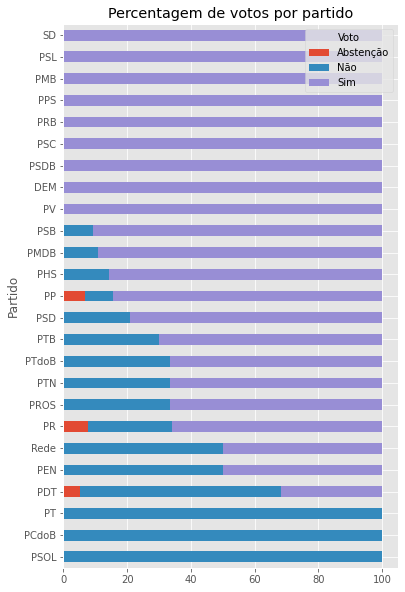

In [285]:
votes = impeachment.groupby('Partido')['Voto'].value_counts().unstack().fillna(0)
votes_normalised = votes.div(votes.sum(axis=1), axis=0).sort_values(by='Sim') * 100
votes_normalised.plot(kind='barh', stacked = True, figsize=(6, 10))
plt.title('Percentagem de votos por partido');

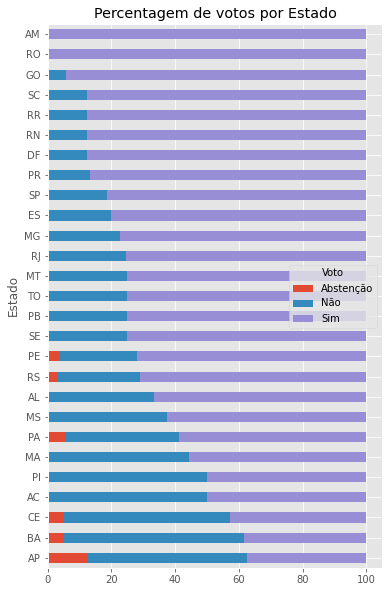

In [286]:
states = impeachment.groupby('Estado')['Voto'].value_counts().unstack().fillna(0)
states_normalised = states.div(states.sum(axis=1), axis=0).sort_values(by='Sim') * 100
states_normalised.plot(kind='barh', stacked = True, figsize=(6, 10))
plt.title('Percentagem de votos por Estado');

In [287]:
# create a list of our conditions
conditions = [
    (states['Sim'] > states['Não']),
    (states['Sim'] < states['Não']),
    (states['Sim'] == states['Não'])
    ]

# create a list of the values we want to assign for each condition
values = [1, 0, 0.5]

# create a new column and use np.select to assign values to it using our lists as arguments
states['Maioria'] = np.select(conditions, values)
states['Estados'] = states.index

In [288]:
br_estados = '/Users/marcio/Development/Projects/impeachment_dilma/data/external/br_states.json'
geo_json_data = json.load(open(br_estados))

mapa = folium.Map(width=500, height=500, location=[-15, -55], zoom_start=4)

mapa.choropleth(
    geo_data=geo_json_data,
    data=states,
    columns=['Estados', 'Maioria'],
    key_on='feature.id',
    fill_color='RdBu', 
    legend_name='Votos pelo impeachment por Estado (0=Nao, 0.5=Empate, 1=Sim)'
)

# display map
mapa

/Users/marcio/Development/Projects/impeachment_dilma/venv/lib/python3.8/site-packages/folium/folium.py:411: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


In [289]:
impeachment['Fala'] = impeachment['Fala'] + " "
corpus_sim = impeachment[impeachment['Voto'] == 'Sim']['Fala'].sum()
corpus_nao = impeachment[impeachment['Voto'] == 'Não']['Fala'].sum()
corpus_abstencao = impeachment[impeachment['Voto'] == 'Abstenção']['Fala'].sum()

In [290]:
tokenized_sim = word_tokenize(corpus_sim)
tokenized_nao = word_tokenize(corpus_nao)
tokenized_abstencao = word_tokenize(corpus_abstencao)

In [291]:
def remove_stopwords(tokenized):
    words = []
    for word in tokenized:
        if word not in stopwords.words('Portuguese') and len(word) > 1:
            words.append(word)
    return words


sim = remove_stopwords(tokenized_sim)
nao = remove_stopwords(tokenized_nao)
abstencao = remove_stopwords(tokenized_abstencao)

In [292]:
def remove_common_words(words_list):
    common_words = ['sim', 'nao', 'voto',
                    'Sr.', 'Sr', 'Brasil', 
                    'aqui', 'Sras', 'Srs', 'Sra', 'eu', 'Eu']
    words = []
    for word in words_list:
        if word not in common_words and len(word) > 1:
            words.append(word)
    s = " "
    return s.join(words)

sim = remove_common_words(sim)
nao = remove_common_words(nao)
abstencao = remove_common_words(abstencao)

In [293]:
# instantiate a word cloud object
wc = WordCloud(
    background_color='white',
    max_words=5000
)

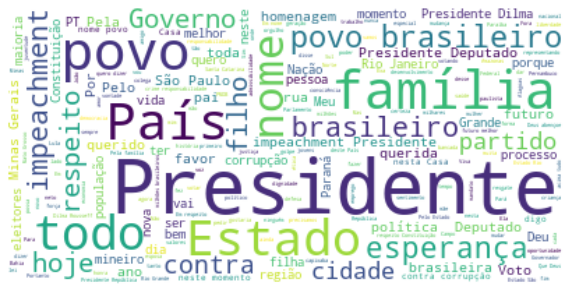

In [294]:
# generate the word cloud
wc.generate(sim)
plt.figure(figsize=(10, 8))
plt.imshow(wc, interpolation='bilinear')
plt.axis('off')
plt.show()

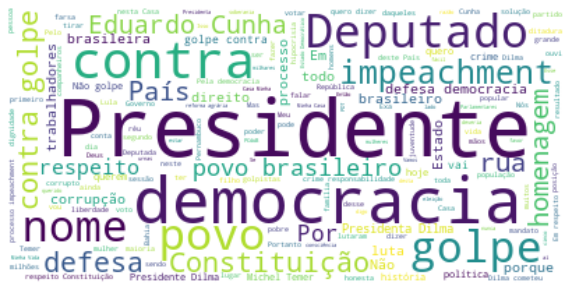

In [295]:
# generate the word cloud
wc.generate(nao)
plt.figure(figsize=(10, 8))
plt.imshow(wc, interpolation='bilinear')
plt.axis('off')
plt.show()

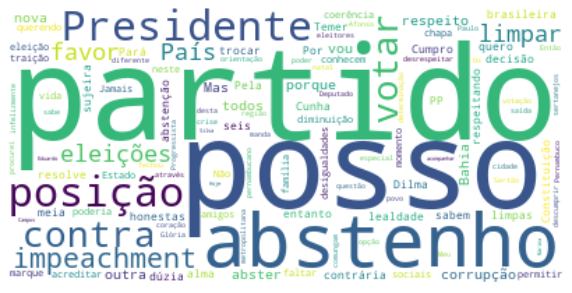

In [296]:
# generate the word cloud
wc.generate(abstencao)
plt.figure(figsize=(10, 8))
plt.imshow(wc, interpolation='bilinear')
plt.axis('off')
plt.show()

In [297]:
impeachment = pd.read_csv('/Users/marcio/Development/Projects/impeachment_dilma/data/interim/impeachment_clean.csv', index_col=0)

In [298]:
impeachment['Fala'] = impeachment['Fala'] + " "
impeachment['Fala'] = impeachment['Fala'].apply(word_tokenize)
impeachment['Fala'] = impeachment['Fala'].apply(remove_stopwords)
impeachment['Fala'] = impeachment['Fala'].apply(remove_common_words)
impeachment['Fala'] = impeachment['Fala'].apply(word_tokenize)

In [299]:
impeachment['Fala'].to_csv('/Users/marcio/Development/Projects/impeachment_dilma/data/processed/impeachment_speeches_vectorized.csv')

In [300]:
speeches = pd.read_csv('/Users/marcio/Development/Projects/impeachment_dilma/data/processed/impeachment_speeches_vectorized.csv')

In [301]:
from sklearn.feature_extraction.text import TfidfVectorizer
vec = TfidfVectorizer()

X = speeches['Fala']

vec.fit(X)
X = pd.DataFrame(vec.transform(X).toarray(), columns=sorted(vec.vocabulary_.keys()))

In [306]:
X

,10,100,105,11,115,120,13,139,15,150,...,ímpio,íntegra,ódio,óleo,ônibus,último,últimos,única,únicas,único
0,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
506,0.14953,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
507,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
508,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
509,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [302]:
from sklearn.cluster import KMeans

modelo = KMeans(n_clusters=2).fit(X)

In [303]:
impeachment['Kmeans'] = modelo.labels_

In [304]:
impeachment.query("Kmeans == 0")['Voto'].value_counts()

Não          88
Sim          27
Abstenção     2
Name: Voto, dtype: int64

In [305]:
impeachment.query("Kmeans == 1")['Voto'].value_counts()

Sim          340
Não           49
Abstenção      5
Name: Voto, dtype: int64